# 4. Part-of-Speech Tagging &amp; Docuscope's Rhetorical Tagging

**Goal**: Learn about the textual analysis method called speech tagging.

Speech-tagging methods can help us humans computationally parse, sort, and filter sentences in a large corpus, so we can retroactively also better understand any words of interest in their contexts of use.

We will be working with the English-language `docuscospacy` model in this lesson—a LLM developed by rhetoricians at Carnegie Mellon University. I'd like to thank them for providing users their helpful documentation, which I have modified to use in this lesson.

In this lesson, we are limited to the English language. Yet, feel free to check out Melanie Walsh's and Quinn Dombrowski's curated tutorials to work with other languages:

- [Chinese POS Tagging](Multilingual/Chinese/03-POS-Keywords-Chinese)
- [Danish POS Tagging](Multilingual/Danish/03-POS-Keywords-Danish)
- [Portuguese POS Tagging](Multilingual/Portuguese/03-POS-Keywords-Portuguese)
- [Russian POS Tagging](Multilingual/Russian/03-POS-Keywords-Russian)
- [Spanish POS Tagging](Multilingual/Spanish/03-POS-Keywords-Spanish)


## 4.1 What are Part-of-Speech &amp; DocuScope Tagging?

### 4.1.1 Part-of-Speech tagging

Part-of-speech (POS) tagging, also called grammatical tagging, is the culmination of decades of work and labor to annotate lexicons by their typical syntactical role(s) by manual and probablistic/computational means. (See [Lancaster U's summary](https://ucrel.lancs.ac.uk/annotation.html#POS) of their original process for more information about POS tagging.)

If you have ever diagrammed a sentence, like below, then you have a sense about POS. Note how the parts-of-speech have been tagged in the sentence. Lookup those tags in the [Lancaster's table of POS](https://ucrel.lancs.ac.uk/annotation.html#POS). 

<img src="../images/pos-tagging-example.png" alt="">

You may currently feel as though these syntactical relations are very dense to understand and use at first. That's normal! Eventually, with some practice, POS tagging can help you explore and surface interesting language patterns used in a particular context and domain worth reporting.

### 4.1.2 DocuScope's *Categorical* Tagging

In addition to POS tags, Docuscope's creators — David Kaufer, Suguru Ishizaki, and Kerry Ishizaki — have been developing a LLM for over 20 years that tag texts for a variety of experiences a writer can create for readers in a text. Docuscope can detect variations of word tokens, based on its token context. For instance, consider the following variations of rhetorical patterns of "I":

- "I" = self-reference
- "I know" = self-confidence
- "I have to do chores today" = self-reluctance
- "I get to do chores today" = eagerness

As the example above demonstrates, Docuscope's rhetorical approach to language assumes that meaning is isolated better in "streams of words," i.e., co-occurrences, rather than individual words. *In other words*, single words, when accompanied by different words, can be interpreted differently. Take the word "sick" below.

- I'm feeling as sick as a dog. = I am feeling very ill.
- That was so sick! = I thought something was really cool.
- I'm sick of talking about AI! = I don't want to talk about AI.

As of 2019, DS's database included 44,000 semantic stream classes and over 70 million unique English language patterns. The result? DocuScope's LLM offers people **categorical tags** to pair with POS tagging.

Categorical tags isolate potential rhetorical patterns within the corpus. To understand what I mean by rhetorical patterns, let's consider DS's categorical tags of `Reasoning` and `Character`. `Reasoning` isolates words or streams of words that are associated with reasoning statements, such as "because," "therefore," "even if," etc., while `Character` isolates multiple dimensions of a person. For example, depending on the word's company, the name "Pauline" might be tagged in relation to work-related characteristics or other domain-specific contextual information. 

So, if you decide to filter your corpus by the co-occurence of Reasoning tagged words with Character words, you could analyze the top and bottom relationships between the *who* is represented in the corpus (or not!) and words related to how they *reason*. From there, you can perhaps begin to imagine how you could conduct an EDA to ask questions of the patterns.

#### How DS tags categories

According to [DS's creators](https://docuscospacy.readthedocs.io/en/latest/docuscope.html), DS "consists of an enormous lexicon organized into a 3-level taxonomy. An analogue would be the lexicons typically used in sentiment analysis." A sentiment analysis typically cateogrizes words and phrases into either positive or negative sentiments. DS works similarily, but it "organizes its strings into many more categories and is orders of magnitude larger. A typical sentiment lexicon may match 3-5 thousand strings. DocuScope matches 100s of millions."

Let's walk through an example sentence and what categorical tags offer in addition to POS tags:

> Jaws is a shrewd cinematic equation which not only gives you one or two very nasty turns when you least expect them but, possibly more important, knows when to make you think another is coming without actually providing it.

When this sentence is analyzed by the DS, it yields the following table (headers are as follows: `tag`==POS tag, `ent`==Named Entity tag; `ent_type`==DS categorical tag).

Note how in addition to POS tagging, DS categorical tags offer a helpful rhetorical and contextual dimension to the token. DS tags offer numerous other categorical tags:

##### *Categorical tag* results from the "Jaws is a shrewd ..." sentence above.

| **** | **text**  | **tag\_** | **ent\_** | **ent\_type\_**       |
|------|-----------|-----------|-----------|-----------------------|
| 0    | Jaws      | NN1       | B         | Character             |
| 1    | is        | VBZ       | B         | InformationStates     |
| 2    | a         | AT1       | I         | InformationStates     |
| 3    | shrewd    | JJ        | B         | Strategic             |
| 4    | cinematic | JJ        | B         | PublicTerms           |
| 5    | equation  | NN1       | B         | AcademicTerms         |
| 6    | which     | DDQ       | B         | SyntacticComplexity   |
| 7    | not       | XX        | B         | ForceStressed         |
| 8    | only      | RR        | I         | ForceStressed         |
| 9    | gives     | VVZ       | B         | Interactive           |
| 10   | you       | PPY       | I         | Interactive           |
| 11   | one       | MC1       | O         |                       |
| 12   | or        | CC        | B         | MetadiscourseCohesive |
| 13   | two       | MC        | B         | InformationExposition |
| 14   | very      | RG        | B         | ConfidenceHigh        |
| 15   | nasty     | JJ        | B         | Negative              |
| 16   | turns     | NN2       | O         |                       |
| 17   | when      | RRQ       | B         | Narrative             |
| 18   | you       | PPY       | I         | Narrative             |
| 19   | least     | RRT       | B         | InformationExposition |
| 20   | expect    | VV0       | B         | Future                |
| 21   | them      | PPHO2     | B         | Narrative             |
| 22   | but       | CCB       | B         | MetadiscourseCohesive |
| 23   | ,         | Y         | B         | Contingent            |
| 24   | possibly  | RR        | I         | Contingent            |
| 25   | more      | RGR       | B         | InformationExposition |
| 26   | important | JJ        | I         | InformationExposition |
| 27   | ,         | Y         | O         |                       |
| 28   | knows     | VVZ       | B         | ConfidenceHigh        |
| 29   | when      | RRQ       | I         | ConfidenceHigh        |
| 30   | to        | TO        | O         |                       |
| 31   | make      | VVI       | B         | Interactive           |
| 32   | you       | PPY       | I         | Interactive           |
| 33   | think     | VVI       | B         | Character             |
| 34   | another   | DD1       | B         | MetadiscourseCohesive |
| 35   | is        | VBZ       | B         | InformationStates     |
| 36   | coming    | VVG       | O         |                       |
| 37   | without   | IW        | O         |                       |
| 38   | actually  | RR        | B         | ForceStressed         |
| 39   | providing | VVG       | B         | Facilitate            |
| 40   | it        | PPH1      | O         |                       |
| 41   | \.        | Y         | O         |                       |


#### Reference Table of DS Categorical Tags

| **\*\*Category \(Cluster\)\*\*** | **\*\*Description\*\***                                                                                                                                                                                                                                                       | **\*\*Examples\*\***                                                                                |
|----------------------------------|-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|-----------------------------------------------------------------------------------------------------|
| **Academic Terms**               | Abstract, rare, specialized, or disciplinary\-specific terms that are indicative of informationally dense writing                                                                                                                                                             | \*market price\*, \*storage capacity\*, \*regulatory\*, \*distribution\*                            |
| **Academic Writing Moves**       | Phrases and terms that indicate academic writing moves, which are common in research genres and are derived from the work of Swales \(1981\) and Cotos et al\. \(2015, 2017\)                                                                                                 | \*in the first section\*, \*the problem is that\*, \*payment methodology\*, \*point of contention\* |
| **Character**                    | References multiple dimensions of a character or human being as a social agent, both individual and collective                                                                                                                                                                | \*Pauline\*, \*her\*, \*personnel\*, \*representatives\*                                            |
| **Citation**                     | Language that indicates the attribution of information to, or citation of, another source\.                                                                                                                                                                                   | \*according to\*, \*is proposing that\*, \*quotes from\*                                            |
| **Citation Authorized**          | Referencing the citation of another source that is represented as true and not arguable                                                                                                                                                                                       | \*confirm that\*, \*provide evidence\*, \*common sense\*                                            |
| **Citation Hedged**              | Referencing the citation of another source that is presented as arguable                                                                                                                                                                                                      | \*suggest that\*, \*just one opinion\*                                                              |
| **Confidence Hedged**            | Referencing language that presents a claim as uncertain                                                                                                                                                                                                                       | \*tends to get\*, \*maybe\*, \*it seems that\*                                                      |
| **Confidence High**              | Referencing language that presents a claim with certainty                                                                                                                                                                                                                     | \*most likely\*, \*ensure that\*, \*know that\*, \*obviously\*                                      |
| **Confidence Low**               | Referencing language that presents a claim as extremely unlikely                                                                                                                                                                                                              | \*unlikely\*, \*out of the question\*, \*impossible\*                                               |
| **Contingent**                   | Referencing contingency, typically contingency in the world, rather than contingency in one's knowledge                                                                                                                                                                       | \*subject to\*, \*if possible\*, \*just in case\*, \*hypothetically\*                               |
| **Description**                  | Language that evokes sights, sounds, smells, touches and tastes, as well as scenes and objects                                                                                                                                                                                | \*stay quiet\*, \*gas\-fired\*, \*solar panels\*, \*soft\*, \*on my desk\*                          |
| **Facilitate**                   | Language that enables or directs one through specific tasks and actions                                                                                                                                                                                                       | \*let me\*, \*worth a try\*, \*I would suggest\*                                                    |
| **First Person**                 | This cluster captures first person\.                                                                                                                                                                                                                                          | \*I\*, \*as soon as I\*, \*we have been\*                                                           |
| **Force Stressed**               | Language that is forceful and stressed, often using emphatics, comparative forms, or superlative forms                                                                                                                                                                        | \*really good\*, \*the sooner the better\*, \*necessary\*                                           |
| **Future**                       | Referencing future actions, states, or desires                                                                                                                                                                                                                                | \*will be\*, \*hope to\*, \*expected changes\*                                                      |
| **Information Change**           | Referencing changes of information, particularly changes that are more neutral                                                                                                                                                                                                | \*changes\*, \*revised\*, \*growth\*, \*modification to\*                                           |
| **Information Change Negative**  | Referencing negative change\.                                                                                                                                                                                                                                                 | \*going downhill\*, \*slow erosion\*, \*get worse\*                                                 |
| **Information Change Positive**  | Referencing positive change\.                                                                                                                                                                                                                                                 | \*improving\*, \*accrued interest\*, \*boost morale\*                                               |
| **Information Exposition**       | Information in the form of expository devices, or language that describes or explains, frequently in regards to quantities and comparisons                                                                                                                                    | \*final amount\*, \*several\*, \*three\*, \*compare\*, \*80%\*                                      |
| **Information Place**            | Language designating places\.                                                                                                                                                                                                                                                 | \*the city\*, \*surrounding areas\*, \*Houston\*, \*home\*                                          |
| **Information Report Verbs**     | Informational verbs and verb phrases of reporting\.                                                                                                                                                                                                                           | \*report\*, \*posted\*, \*release\*, \*point out\*                                                  |
| **Information States**           | Referencing information states, or states of being\.                                                                                                                                                                                                                          | \*is\*, \*are\*, \*existing\*, \*been\*                                                             |
| **Information Topics**           | Referencing topics, usually nominal subjects or objects, that indicate the “aboutness” of a text                                                                                                                                                                              | \*time\*, \*money\*, \*stock price\*, \*phone interview\*                                           |
| **Inquiry**                      | Referencing inquiry, or language that points to some kind of inquiry or investigation                                                                                                                                                                                         | \*find out\*, \*let me know if you have any questions\*, \*wondering if\*                           |
| **Interactive**                  | Addresses from the author to the reader or from persons in the text to other persons\. The address comes in the language of everyday conversation, colloquy, exchange, questions, attention\-getters, feedback, interactive genre markers, and the use of the second person\. | \*can you\*, \*thank you for\*, \*please see\*, \*sounds good to me\*                               |
| **Metadiscourse Cohesive**       | The use of words to build cohesive markers that help the reader navigate the text and signal linkages in the text, which are often additive or contrastive                                                                                                                    | \*or\*, \*but\*, \*also\*, \*on the other hand\*, \*notwithstanding\*, \*that being said\*          |
| **Metadiscourse Interactive**    | The use of words to build cohesive markers that interact with the reader                                                                                                                                                                                                      | \*I agree\*, \*let’s talk\*, \*by the way\*                                                         |
| **Narrative**                    | Language that involves people, description, and events extending in time                                                                                                                                                                                                      | \*today\*, \*tomorrow\*, \*during the\*, \*this weekend\*                                           |
| **Negative**                     | Referencing dimensions of negativity, including negative acts, emotions, relations, and values                                                                                                                                                                                | \*does not\*, \*sorry for\*, \*problems\*, \*confusion\*                                            |
| **Positive**                     | Referencing dimensions of positivity, including actions, emotions, relations, and values                                                                                                                                                                                      | \*thanks\*, \*approval\*, \*agreement\*, \*looks good\*                                             |
| **Public Terms**                 | Referencing public terms, concepts from public language, media, the language of authority, institutions, and responsibility                                                                                                                                                   | \*discussion\*, \*amendment\*, \*corporation\*, \*authority\*, \*settlement\*                       |
| **Reasoning**                    | Language that has a reasoning focus, supporting inferences about cause, consequence, generalization, concession, and linear inference either from premise to conclusion or conclusion to premise                                                                              | \*because\*, \*therefore\*, \*analysis\*, \*even if\*, \*as a result\*, \*indicating that\*         |
| **Responsibility**               | Referencing the language of responsibility\.                                                                                                                                                                                                                                  | \*supposed to\*, \*requirements\*, \*obligations\*                                                  |
| **Strategic**                    | This dimension is active when the text structures strategies activism, advantage\-seeking, game\-playing cognition, plans, and goal\-seeking\.                                                                                                                                | \*plan\*, \*trying to\*, \*strategy\*, \*decision\*, \*coordinate\*, \*look at the\*                |
| **Syntactic Complexity**         | The features in this category are often what are called “function words,” like determiners and prepositions\.                                                                                                                                                                 | \*the\*, \*to\*, \*for\*, \*in\*, \*a lot of\*                                                      |
| **Uncertainty**                  | References uncertainty, when confidence levels are unknown\.                                                                                                                                                                                                                  | \*kind of\*, \*I have no idea\*, \*for some reason\*                                                |
| **Updates**                      | References updates that anticipate someone searching for information and receiving it                                                                                                                                                                                         | \*already\*, \*a new\*, \*now that\*, \*here are some\*                                             |

## 4.2 Why is Speech Tagging Useful?

<img src="https://imgs.xkcd.com/comics/language_nerd.png" alt="I don't mean to go all [Language Nerd](https://xkcd.com/1443/) on you, but parts of speech are important. Even if they seem kind of boring. *Parts of speech* are the grammatical units of language — such as (in English) nouns, verbs, adjectives, adverbs, pronouns, and prepositions. Each of these parts of speech plays a different role in a sentence.">


By computationally identifying parts of speech, we can start computationally exploring *syntax*, the relationship between words, rather than only focusing on words in isolation, as other analyses perform such as *tf-idf*. 

Though parts of speech may seem pedantic, and difficult to apply at first, the POS and DS tags (*LANGUAGE AS DIGITAL DATA!*) help us work with our computational media, i.e., computers, to work toward that ever-elusive abstract noun: *meaning*.

The *xkcd* comic above nicely illustrates how words are not monolithic or static in meaning. Why? Language is a dynamic part of the human experience. Language has a history—a history that feeds into what we do with language right now, which also impacts how words develop into our future. Consequently, syntactical tagging of word relationships - even within the seemingly simple language unit that we call sentences - is difficult. Words can and do shift roles and functions and how they impact social relationships (rhetoric!), because langauge is more than a "bag of words" and their syntactical relationships, e.g. "legit" as *adjective* and *adverb*. We've tangled up language in all aspects of our world.

## 4.3 Speech Tagging Lesson

### 4.3.1 Install necessary libraries

In [1]:
%pip install -U spacy==3.5.0 
# Special modified version of tmtoolkit to work with docuscospacy (I logged the issue with DS, so this works with 0.2.3)
%pip install pip install https://github.com/lingeringcode/temptmtoolkit/archive/refs/heads/main.zip
%pip install docuscospacy==0.2.3
# Run the install command for 'json' just in case you don't have it


     ---------------------------------------- 0.0/12.2 MB ? eta -:--:--
     ---------------------------------------- 0.0/12.2 MB 1.4 MB/s eta 0:00:09
      --------------------------------------- 0.3/12.2 MB 2.9 MB/s eta 0:00:05
     -- ------------------------------------- 0.8/12.2 MB 5.6 MB/s eta 0:00:03
     --- ------------------------------------ 1.2/12.2 MB 6.4 MB/s eta 0:00:02
     ---- ----------------------------------- 1.3/12.2 MB 5.4 MB/s eta 0:00:03
     ----- ---------------------------------- 1.7/12.2 MB 6.4 MB/s eta 0:00:02
     -------- ------------------------------- 2.5/12.2 MB 7.5 MB/s eta 0:00:02
     -------- ------------------------------- 2.7/12.2 MB 7.6 MB/s eta 0:00:02
     ----------- ---------------------------- 3.4/12.2 MB 7.7 MB/s eta 0:00:02
     ------------ --------------------------- 3.9/12.2 MB 8.4 MB/s eta 0:00:01
     --------------- ------------------------ 4.7/12.2 MB 9.1 MB/s eta 0:00:01
     ---------------- ----------------------- 4.9/12.2 MB 8

### 4.3.2 Import Libraries + EDA

In [2]:
import spacy
from spacy import displacy
from temptmtoolkit.corpus import Corpus, vocabulary_size, corpus_num_tokens
import re
from docuscospacy.corpus_analysis import convert_corpus, frequency_table, tags_table, ngrams_table, coll_table, tags_dtm, kwic_center_node, keyness_table
import pandas as pd
import json
import statistics

#### Quick EDA to understand the data

<class 'dict'>

Key: 0_5
Value: {'nb_index': 0, 'nb_path': '../collection/original/kernels/20230425/hiramcho__moa-tabnet-with-pca-rank-gauss/moa-tabnet-with-pca-rank-gauss.ipynb', 'cell_index': 5, 'cell_type': 'code', 'source': '### General ###\\nimport os\\nimport sys\\nimport copy\\nimport tqdm\\nimport pickle\\nimport random\\nimport warnings\\nwarnings.filterwarnings("ignore")\\nsys.path.append("../input/rank-gauss")\\nos.environ["CUDA_LAUNCH_BLOCKING"] = \'1\'\\n\\n### Data Wrangling ###\\nimport numpy as np\\nimport pandas as pd\\nfrom scipy import stats\\nfrom gauss_rank_scaler import GaussRankScaler\\n\\n### Data Visualization ###\\nimport seaborn as sns\\nimport matplotlib.pyplot as plt\\nplt.style.use("ggplot")\\n\\n### Machine Learning ###\\nfrom sklearn.decomposition import PCA\\nfrom sklearn.preprocessing import LabelEncoder\\nfrom sklearn.metrics import roc_auc_score, log_loss\\nfrom sklearn.preprocessing import QuantileTransformer\\nfrom sklearn.feature_selection import 
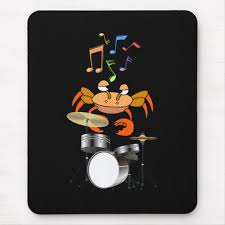
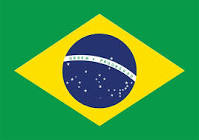
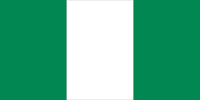
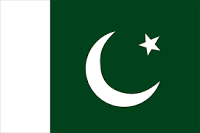
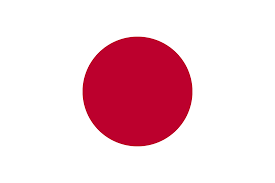
...
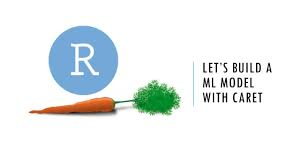
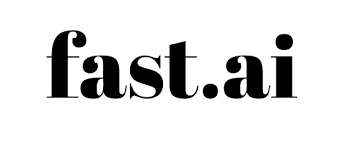
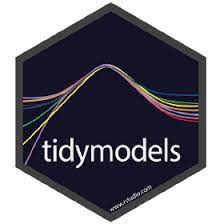
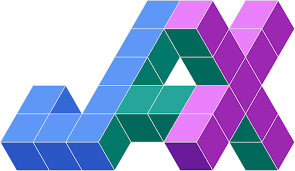
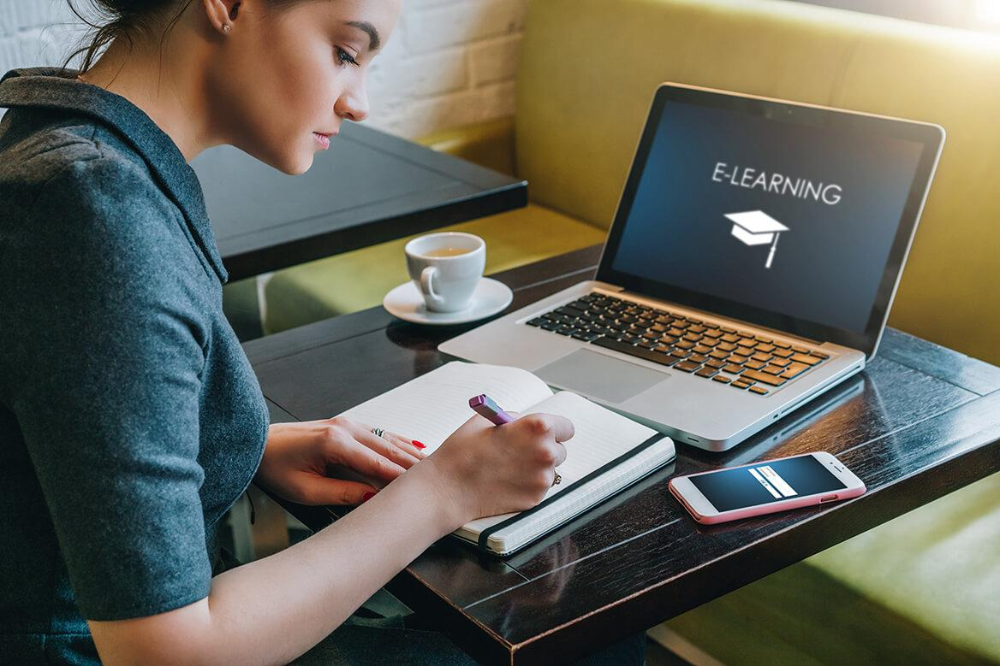

In [3]:
##############
## Import Data
##############

# Open/read the sample JSON file
file_adj_corpus = open('../data/04-textual-analysis/kaggle-nb-example/dict_viz_and_adjacent_cells.json', 'r')

# Convert the JSON data into python dict object
dict_adj_corpus = json.load(file_adj_corpus)

# Check the type of the Python object
print(type(dict_adj_corpus))

# Iterate through the dictionary
# And print the key: value pairs
for key, value in dict_adj_corpus.items():
  print(f"\nKey: {key}")
  print(f"Value: {value}\n")

# Close the opened sample JSON file
file_adj_corpus.close()

#### What is the sum of cells adjacent to visual cells per position?

**PROVENANCE**: This data comes from Kaggle.com, where data scientists share data and notebooks that analyze it. This set specifically collected notebooks that employ machine-learning techniques with the goal to understand how people used visuals throughout the process. Consequently, the data are organized by two factors:

1. whether or not a notebook cell is a "code" cell or a "Markdown" cell, and 
2. whether the cell is positioned before or after a cell that produces a visualization.

Review the summary stats work below to get to know the data some more before we use other more specific `.txt` files that I created from this particular data set.

In [4]:
####################################################################
# 1. What is the sum of cells adjacent to visual cells per position?
####################################################################
def sum_adj_cells(c):
  md_before_count = 0
  md_after_count = 0
  code_before_count = 0
  code_after_count = 0
  for vcell_key in c:
    if c[vcell_key]['adjacent_before'] != 'None':
      if c[vcell_key]['adjacent_before']['cell_type'] == 'markdown':
        md_before_count = md_before_count + 1
      elif c[vcell_key]['adjacent_before']['cell_type'] == 'code':
        code_before_count = code_before_count + 1
    elif c[vcell_key]['adjacent_after'] != 'None':
      if c[vcell_key]['adjacent_after']['cell_type'] == 'markdown':
        md_after_count = md_after_count + 1
      elif c[vcell_key]['adjacent_after']['cell_type'] == 'code':
        code_after_count = code_after_count + 1

  print(
    'Q1: What is the sum of cells adjacent to visual cells per posiiton?'
    '\n- md_before_count:', md_before_count,
    '\n- md_after_count:', md_after_count,
    '\n- code_before_count:', code_before_count,
    '\n- code_after_count:', code_after_count,
    '\n- TOTAL:', md_before_count+md_after_count+code_before_count+code_after_count
  )

sum_adj_cells(dict_adj_corpus)

Q1: What is the sum of cells adjacent to visual cells per posiiton?
- md_before_count: 6749 
- md_after_count: 54 
- code_before_count: 3546 
- code_after_count: 53 
- TOTAL: 10402


#### What positions are visual cells in the notebook?

In [5]:
##################################################
# 2. What positions are visual cells in the notebook?
##################################################
def describe_viz_cell_positions(c):
  # Overall positioning
  cp_occurrences = 0
  ni_cp_occurrences = 0
  overall_cell_position_sum = 0
  no_import_cell_position_sum = 0
  sum_cells_sum = 0
  overall_position_list = []
  no_import_position_list = []
  sum_of_cells_list = []
  for vcell_key in c:
    # Tally occurrences
    cp_occurrences = cp_occurrences+1
    sum_cells_sum = sum_cells_sum+c[vcell_key]['total_cells_in_nb']

    # List total cells in notebooks
    sum_of_cells_list.append(c[vcell_key]['total_cells_in_nb'])

    overall_cell_position_sum = overall_cell_position_sum + c[vcell_key]['cell_position_in_nb']
    overall_position_list.append(c[vcell_key]['cell_position_in_nb'])

    # Filter out imports
    re_import = r'import\s'
    import_match = re.match(re_import, c[vcell_key]['source'])
    # print(import_match)
    if import_match == None:
      ni_cp_occurrences = ni_cp_occurrences+1
      no_import_cell_position_sum = no_import_cell_position_sum + c[vcell_key]['cell_position_in_nb']
      no_import_position_list.append(c[vcell_key]['cell_position_in_nb'])

  # MEDIAN
  # Sort the lists in ascending order
  overall_position_list = sorted(overall_position_list)
  no_import_position_list = sorted(no_import_position_list)
  sum_of_cells_list = sorted(sum_of_cells_list)

  overall_position_median = statistics.median(overall_position_list)
  no_imports_position_median = statistics.median(no_import_position_list)
  sum_cells_median = statistics.median(sum_of_cells_list)

  # MODE
  # Round numbers in list to whole number
  whole_num_overall_position_list = []
  for op in overall_position_list:
    whole_num_overall_position_list.append(round(op))
  
  whole_num_ni_position_list = []
  for nip in no_import_position_list:
    whole_num_ni_position_list.append(round(nip))
  
  overall_position_mode = statistics.mode(whole_num_overall_position_list)
  no_imports_position_mode = statistics.mode(whole_num_ni_position_list)
  sum_cells_mode = statistics.mode(sum_of_cells_list)

  print(
    '\n\nQ2: What positions are visual cells in the notebook?',
    '\n- OVERALL Avg Mean Cell Position:', overall_cell_position_sum / cp_occurrences,
    '\n- OVERALL Median Cell Position:', overall_position_median,
    '\n- OVERALL Mode Cell Position:', overall_position_mode,
    '\n- NO IMPORTS Avg Mean Cell Position:', no_import_cell_position_sum / ni_cp_occurrences,
    '\n- NO IMPORTS Median Cell Position:', no_imports_position_median,
    '\n- NO IMPORTS Mode Cell Position:', no_imports_position_mode,
    '\n- TOTAL CELLS Avg Mean:', sum_cells_sum / cp_occurrences,
    '\n- TOTAL CELLS Median:', sum_cells_median,
    '\n- TOTAL CELLS Mode:', sum_cells_mode,
    '\n- OVERALL Sum Total Cells:', cp_occurrences,
    '\n- NO IMPORTS Sum Total Cells:', ni_cp_occurrences,
    '\n- IMPORTS ONLY Sum Total Cells:', (ni_cp_occurrences-cp_occurrences),
    '\n'
  )

describe_viz_cell_positions(dict_adj_corpus)



Q2: What positions are visual cells in the notebook? 
- OVERALL Avg Mean Cell Position: 65.78426175765347 
- OVERALL Median Cell Position: 41.009803921568626 
- OVERALL Mode Cell Position: 2 
- NO IMPORTS Avg Mean Cell Position: 68.74707099136471 
- NO IMPORTS Median Cell Position: 43.014084507042256 
- NO IMPORTS Mode Cell Position: 21 
- TOTAL CELLS Avg Mean: 135.87084092434557 
- TOTAL CELLS Median: 99 
- TOTAL CELLS Mode: 827 
- OVERALL Sum Total Cells: 10429 
- NO IMPORTS Sum Total Cells: 9707 
- IMPORTS ONLY Sum Total Cells: -722 



#### Other EDA?

Feel free to use the pandas dataframes below to do any more EDA, if you'd like. But, the main part of this lesson is to learn more about POS and Categorical tagging.

In [6]:
# Isolate NON-IMPORT-ADJACENT Markdown Cells
def get_non_import_adj_md_cells(c):
  list__all_cell_content = []
  list__ni_md_before_cell_content = []
  list__ni_md_after_cell_content = []
  for vcell_key in c:
    # Filter out imports
    re_import = r'import\s'
    import_match = re.match(re_import, c[vcell_key]['source'])
    if (import_match == None):
      # Before Vcell
      if c[vcell_key]['adjacent_before'] != 'None' and (c[vcell_key]['adjacent_before']['cell_type'] == 'markdown'):
        list__ni_md_before_cell_content.append(c[vcell_key]['adjacent_before']['source'])
        list__all_cell_content.append(c[vcell_key]['adjacent_before']['source'])
      # After Vcell
      elif c[vcell_key]['adjacent_after'] != 'None' and (c[vcell_key]['adjacent_after']['cell_type'] == 'markdown'):
        list__ni_md_after_cell_content.append(c[vcell_key]['adjacent_after']['source'])
        list__all_cell_content.append(c[vcell_key]['adjacent_after']['source'])

  dict__ni_md_cell_contents = [
    {'all_vcells': list__all_cell_content},
    {'before_vcells': list__ni_md_before_cell_content},
    {'after_vcells': list__ni_md_after_cell_content}
  ]

  return dict__ni_md_cell_contents

In [7]:
# Remove "Import" cells from samples
dict__ni_adj_corpus = get_non_import_adj_md_cells(dict_adj_corpus)

# Convert dictionaries to dataframes
df__ALL_ni_adj_corpus = pd.DataFrame(dict__ni_adj_corpus[0]['all_vcells']).rename(columns={0:'all_vcells'})
df__BEFORE_ni_adj_corpus = pd.DataFrame(dict__ni_adj_corpus[1]['before_vcells']).rename(columns={0:'before_vcells'})
df__AFTER_ni_adj_corpus = pd.DataFrame(dict__ni_adj_corpus[2]['after_vcells']).rename(columns={0:'after_vcells'})

In [8]:
# Optional EDA code

### 4.3.3 Download LLM

Ok, now that you know the data a little better than before, we can start our POS and Categorical tags analysis. 

First, we need to download DocuScope's LLM: `en_docusco_spacy`. Their (English-only) LLM will process and make predictions about our texts. 

- **NOTE**: Another commonly used LLM is spacy's `en_core_web_sm`. This LLM was trained on the annotated "OntoNotes" corpus. 

To download and install the `en_docusco_spacy` model, 

1. Execute the cell below: `%pip install en_docusco_spacy`. 
2. Execute the subsequent cell that uses `spacy` to load the `en_docusco_spacy` model as a variable method.

Now, we can use DS's LLM!

In [9]:
%pip install https://huggingface.co/browndw/en_docusco_spacy/resolve/main/en_docusco_spacy-any-py3-none-any.whl


     ---------------------------------------- 0.0/7.5 MB ? eta -:--:--
     - -------------------------------------- 0.2/7.5 MB 6.7 MB/s eta 0:00:02
     -- ------------------------------------- 0.5/7.5 MB 8.1 MB/s eta 0:00:01
     ----- ---------------------------------- 1.0/7.5 MB 8.3 MB/s eta 0:00:01
     -------- ------------------------------- 1.6/7.5 MB 10.0 MB/s eta 0:00:01
     ----------- ---------------------------- 2.1/7.5 MB 9.6 MB/s eta 0:00:01
     ------------- -------------------------- 2.5/7.5 MB 10.2 MB/s eta 0:00:01
     ---------------- ----------------------- 3.1/7.5 MB 10.4 MB/s eta 0:00:01
     ------------------- -------------------- 3.7/7.5 MB 10.7 MB/s eta 0:00:01
     --------------------- ------------------ 4.0/7.5 MB 10.3 MB/s eta 0:00:01
     ----------------------- ---------------- 4.4/7.5 MB 10.5 MB/s eta 0:00:01
     ------------------------- -------------- 4.8/7.5 MB 9.9 MB/s eta 0:00:01
     -------------------------- ------------- 5.0/7.5 MB 9.4 MB/

In [10]:
nlp = spacy.load('en_docusco_spacy')

### 4.3.4 Conducting a corpus analysis with docuscopacy

In this part of the lesson, we will follow the `docuscospacy` package's [documentation tutorial](https://docuscospacy.readthedocs.io/en/latest/corpus_analysis.html). 

Using this LLM, we will conduct some of the following actions to conduct a corpus analysis:

- Token frequencies
- Ngrams
- Word collocations around a node word
- Keyword comparisions against a reference corpus

What's great about `docuscospacy` (DS) is how it provides methods by which review the results from the analysis—another form of EDA! 

For example, DS can render outputs, such as tables with either POS or DS tags. This will help you differentiate potential moments when a POS like *can* functions as a *noun* vs. *can as verb*. It may prove interesting! Who knows until see what language patterns may be found!

In another example, we'll review how `docuscospacy` conducts and aggregates multi-token sequenced tags, e.g., where *in spite of* is tagged as a token sequence, it is combined into a signle token.

Overall, our goal is to get to know the data and get creative with how we analyze it.

### 4.3.5 Load Corpus Data and Pre-Processing the Corpus

Accurate tagging requires some processing/cleaning of the data. In the function below, we 

1. Make all of the text uniformly lowercase, because remember that computers define every type of character, such as lowercase `k` vs. uppercase `K`.
2. Remove any potential HTML tags in this particular corpus.
3. Split the possessive `its` into two tokens. 
4. Removes carriage returns, tabs, extra spaces, etc.

In [11]:
def pre_process(txt):
    # 1. remove lowercase
    txt=txt.lower()
    # 2. remove HTML tags
    txt=re.sub('</?.*?>','', txt)
    # 3. remove posessives
    txt = re.sub(r'\bits\b', 'it s', txt)
    txt = re.sub(r'\bIts\b', 'It s', txt)
    # Split text into tokens (tokenize it)
    txt = " ".join(txt.split())
    
    return(txt)

In [12]:
# You may need to change this variable, if you end up using diferent data sets
nlp.max_length = 1300000
# 1300000 for Kaggle's by-position
print(nlp.max_length)

1300000


In [55]:
%%time
corp = Corpus.from_folder(
    # Note how this uses a folder reference, not just a file.
    # It parses txt files divvied up into differently sorted parts of a corpus/es

    # CHOOSE YOUR CORPUS! :-) The lesson starts by using the Kaggle 'by-position' data.
    # Use this data first. Then, for your application, choose another set if you'd like

    '../data/04-textual-analysis/jeopardy', 
    # '../data/04-textual-analysis/kaggle-nb-example/by-votes',
    
    # NOTE: For the sake of file sizes and in-memory work, I randomly sampled the Jeopardy questions (10000 per document set)
    # '../data/04-textual-analysis/jeopardy/split', 
    spacy_instance=nlp, # Our loaded LLM
    raw_preproc=[pre_process], # Cleaning function
    spacy_token_attrs=['tag', 'ent_iob', 'ent_type', 'is_punct'] #Run these tagging functions
)

CPU times: total: 8.42 s
Wall time: 21.1 s


### 4.3.6 Basic Summary Stats About Corpus

It is always a good idea to calcu;ate and review some aggregated information about your corpus. These stats can help you identify potential oddities before you even begin the other work. And, some of the values will be useful later.

In [56]:
corpus_total = corpus_num_tokens(corp)
corpus_types = vocabulary_size(corp)
total_punct = []
for i in range(0,len(corp)):
    total_punct.append(sum(corp[i]['is_punct']))
total_punct = sum(total_punct)
non_punct = corpus_total - total_punct

print(
    'Aphanumeric tokens:', non_punct, 
    '\nPunctuation tokens:', total_punct, 
    '\nTotal tokens:', corpus_total, 
    '\nToken types:', corpus_types
)

Aphanumeric tokens: 447075 
Punctuation tokens: 128240 
Total tokens: 575315 
Token types: 36790


### 4.3.7 Converting the corpus to a DS class object

Before we generate any tables, we first need to convert the corpus into a convenient object that we can manipulate. From `docuscospacy.corpus_analysis` we will import a number of functions including `convert_corpus`, which takes the object produced by the `Corpus.from_folder` function and converts it into a dictionary, whose keys are the names of the corpus files.

In [57]:
from docuscospacy.corpus_analysis import convert_corpus, frequency_table, tags_table, ngrams_table, coll_table, tags_dtm, kwic_center_node, keyness_table

In [58]:
tp = convert_corpus(corp)

In [59]:
# Listify the keys to review them for accuracy: Did it get all of the desired files?
list(tp.keys())

['split-q_greater_than_1000',
 'split-q_greater_than_400_less_than_1000',
 'split-q_less_than_400']

In [60]:
# Listify a file's content in the dictionary by changing the positional values to change the file and tagged tokens in the file
list(tp.values())[1][10:]

[('was ', 'VBDZ', 'B-Narrative'),
 ('adopted ', 'VVN', 'O-'),
 ('from ', 'II', 'O-'),
 ('belfort', 'NN1', 'O-'),
 (', ', 'Y', 'O-'),
 ('the ', 'AT', 'B-InformationPlace'),
 ('city ', 'NN1', 'I-InformationPlace'),
 ('where ', 'CS', 'O-'),
 ('an ', 'AT1', 'O-'),
 ('early ', 'JJ', 'B-Narrative'),
 ('model ', 'NN1', 'B-AcademicTerms'),
 ('was ', 'VBDZ', 'B-Narrative'),
 ('made', 'VVN', 'B-InformationReportVerbs'),
 ('" ', 'Y', 'O-'),
 ('"', 'Y', 'O-'),
 ('he', 'PPHS1', 'B-Character'),
 ("'s ", 'VBZ', 'I-Character'),
 ('the ', 'AT', 'O-'),
 ('member ', 'NN1', 'B-InformationTopics'),
 ('of ', 'IO', 'O-'),
 ('p.funk ', 'NN1', 'O-'),
 ('seen ', 'VVN', 'B-Description'),
 ('here', 'RL', 'B-Narrative'),
 (':', 'Y', 'O-'),
 ('" ', 'Y', 'O-'),
 ('"', 'Y', 'O-'),
 ('later ', 'RRR', 'B-Narrative'),
 ('caught ', 'VVN', 'O-'),
 ('with ', 'IW', 'O-'),
 ('his ', 'APPGE', 'B-Description'),
 ('hand ', 'NN1', 'I-Description'),
 ('figuratively ', 'RR', 'B-AcademicTerms'),
 ('in ', 'II', 'O-'),
 ('the ', 'AT'

### 4.3.8 Generate Frequency Tables

We can use DS's `frequency_table` function to easily review counts. Here's the description from the API:

<blockquote>
<h4><a href="https://docuscospacy.readthedocs.io/en/latest/api.html#corpus-analysis-frequency-table-tok-n-tokens-count-by-pos">corpus_analysis.frequency_table(tok, n_tokens, count_by=’pos’)</a></h4>
<p>Generate a count of token frequencies.</p>
<div><dl class="field-list simple">
<dt class="field-odd">Parameters</dt>
<dd class="field-odd"><ul class="simple">
<li><p><strong>tok</strong> - A dictionary of tuples as generated by the <cite>convert_corpus</cite> function</p></li>
<li><p><strong>n_tokens</strong> - A count of total tokens against which to normalize</p></li>
<li><p><strong>count_by</strong> - One of ‘pos’ or ‘ds’ for aggregating tokens</p></li>
</ul>
</dd>
<dt class="field-even">Return</dt>
<dd class="field-even"><ul class="simple">
<li><p>a dataframe of absolute frequencies, normalized frequencies (per million tokens) and ranges</p></li>
</ul>
</dd>
</dl>
</div>
</blockquote>

`frequency_table` also [normalizes](https://en.wikipedia.org/wiki/Normalization_(statistics)) the data across the corpus, so that the counts can be compared across the corpi, i.e. compare and contrast the returned absolute frequencies (col `AF`), normalized relative frequencies (per million tokens) (col `RF`), and ranges (col `Range`). token shares a common scale.

#### 4.3.8.1 POS tables

In our first frequency table, we will normalize the counts with the non_punct (or the total number of tokens that are not punctuation), because POS token counts omit tokens tagged as punctuation. Later we will count ALLTHETHINGS, since DS includes punctuation.

In [61]:
freq_table_POS = frequency_table(
    tok=tp, # converted corpus into dict objs
    count_by='pos', # Count by POS tags
    n_tokens=non_punct # norm the corpus by excluding punctuation
)

In [62]:
freq_table_POS.head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
the,AT,25344,56688.48,100.00
this,DD1,18029,40326.57,100.00
of,IO,15678,35067.94,100.00
in,II,14256,31887.27,100.00
a,AT1,12428,27798.47,100.00
it,PPH1,5167,11557.34,100.00
for,IF,5143,11503.66,100.00
is,VBZ,4825,10792.37,100.00
's,GE,4823,10787.90,100.00
was,VBDZ,4200,9394.40,100.00


Since it's a dataframe, we can filter and sort it easily with the `query()` method. Yay!

Below, we filter for an AF greater than 10 and token tags as verbs (starting with ‘V’). 

Refer to the [CLAWS7 POS table](https://ucrel.lancs.ac.uk/claws7tags.html) for desired speech tags to filter against.

In [63]:
freq_table_POS.query('AF > 10 and Tag.str.startswith("V")').head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
is,VBZ,4825,10792.37,100.00
was,VBDZ,4200,9394.40,100.00
's,VBZ,2559,5723.87,100.00
are,VBR,1153,2578.99,100.00
be,VBI,913,2042.16,100.00
has,VHZ,842,1883.35,100.00
called,VVN,781,1746.91,100.00
named,VVN,756,1690.99,100.00
seen,VVN,730,1632.84,100.00
can,VM,682,1525.47,100.00


In [64]:
# Filter for adverbs, yo! How are we modifying those verbs?
freq_table_POS.query('Tag.str.startswith("R")').head(20).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
here,RL,1020,2281.50,100.00
also,RR,556,1243.64,100.00
up,RP,547,1223.51,100.00
out,RP,367,820.89,100.00
now,RT,310,693.40,100.00
just,RR,295,659.84,100.00
most,RGT,266,594.98,100.00
once,RR,241,539.06,100.00
only,RR,232,518.93,100.00
often,RR,231,516.69,100.00


#### 4.3.8.2 DS category tables

Note how we normalize by ‘corpus_total’ as DocuScope includes punctuation in its tagging system.

In [65]:
freq_table_DS = frequency_table(
    tok=tp, 
    n_tokens=corpus_total, 
    count_by='ds'
)

In [66]:
freq_table_DS.head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
the,Untagged,13730,23865.19,100.00
this,Narrative,12891,22406.86,100.00
of,Untagged,11083,19264.23,100.00
in,Untagged,7293,12676.53,100.00
a,Untagged,6784,11791.80,100.00
to,Untagged,3479,6047.12,100.00
for,Untagged,3466,6024.53,100.00
's,Untagged,3279,5699.49,100.00
was,Narrative,2816,4894.71,100.00
this,Untagged,2433,4228.99,100.00


Let's sort by DS tags!

Review the DS tags in their [user docs](https://docuscospacy.readthedocs.io/en/latest/docuscope.html#categories).

In [67]:
# By INQUIRY
freq_table_DS.query('Tag.str.startswith("Inquiry")').head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
the clue,Inquiry,353,613.58,100.00
invented,Inquiry,51,88.65,100.00
discovered,Inquiry,46,79.96,100.00
a famous,Inquiry,43,74.74,100.00
explorer,Inquiry,42,73.00,100.00
when this,Inquiry,40,69.53,100.00
reads the,Inquiry,35,60.84,100.00
clue,Inquiry,30,52.15,100.00
discovery,Inquiry,22,38.24,100.00
invention,Inquiry,21,36.50,100.00


In [68]:
# By INFORMATION TOPICS
freq_table_DS.query('Tag.str.startswith("Information Topics")').head(20).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
title,Information Topics,470,816.94,100.00
name,Information Topics,457,794.35,100.00
the name,Information Topics,273,474.52,100.00
group,Information Topics,187,325.04,100.00
musical,Information Topics,177,307.66,100.00
capital,Information Topics,158,274.63,100.00
named,Information Topics,148,257.25,100.00
series,Information Topics,140,243.34,100.00
family,Information Topics,132,229.44,100.00
company,Information Topics,131,227.70,100.00


In [69]:
# By INFORMATION REPORT VERBS
freq_table_DS.query('Tag.str.startswith("Information Report Verbs")').head(20).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
made,Information Report Verbs,372,646.60,100.00
include,Information Report Verbs,193,335.47,100.00
make,Information Report Verbs,166,288.54,100.00
built,Information Report Verbs,122,212.06,100.00
called the,Information Report Verbs,116,201.63,100.00
makes,Information Report Verbs,100,173.82,100.00
making,Information Report Verbs,95,165.13,100.00
including,Information Report Verbs,87,151.22,100.00
building,Information Report Verbs,81,140.79,100.00
created,Information Report Verbs,80,139.05,100.00


In [70]:
# By INFORMATION CHANGE
freq_table_DS.query('Tag.str.startswith("Information Change")').head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
became the,Information Change,131,227.70,100.00
became,Information Change,119,206.84,100.00
death,Information Change Negative,91,158.17,100.00
double,Information Change,66,114.72,100.00
into the,Information Change,61,106.03,100.00
became a,Information Change,60,104.29,100.00
formed,Information Change,60,104.29,100.00
died,Information Change Negative,49,85.17,100.00
into a,Information Change,42,73.00,100.00
become,Information Change,33,57.36,100.00


In [71]:
# By REASONING
freq_table_DS.query('Tag.str.startswith("Reasoning")').head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
because,Reasoning,109,189.46,100.00
", so",Reasoning,66,114.72,100.00
", for",Reasoning,52,90.39,100.00
based on,Reasoning,47,81.69,100.00
all the,Reasoning,42,73.00,100.00
composed,Reasoning,42,73.00,100.00
category,Reasoning,36,62.57,100.00
based on a,Reasoning,35,60.84,100.00
effect,Reasoning,29,50.41,100.00
especially,Reasoning,29,50.41,100.00


In [72]:
# By UNCERTAINTY
freq_table_DS.query('Tag.str.startswith("Uncertainty")').head(10).style.hide(axis='index').format(precision=2)

Token,Tag,AF,RF,Range
kind of,Uncertainty,62,107.77,100.00
whether,Uncertainty,24,41.72,100.00
wilder,Uncertainty,9,15.64,100.00
about 40,Uncertainty,8,13.91,100.00
at about,Uncertainty,8,13.91,100.00
about 20,Uncertainty,7,12.17,100.00
about 60,Uncertainty,7,12.17,100.00
about 10,Uncertainty,6,10.43,100.00
about 50,Uncertainty,6,10.43,100.00
someone else 's,Uncertainty,6,10.43,100.00


#### 4.3.8.3 Tags Frequency Tables

We can focus on the tag counts by using the `tags_table` function. It works just like the `frequency_table` function, taking a dictionary created by the `convert_corpus` function, an integer against which to normalize, and a `count_by` argument of either `‘pos’` or `‘ds’`.

In [73]:
tags_freq_table_POS = tags_table(
    tok=tp,
    n_tokens=non_punct,
    count_by='pos'
)

In [74]:
tags_freq_table_POS.head(10).style.hide(axis='index').format(precision=2)

Tag,AF,RF,Range
NN1,116736,26.11,100.00
II,35035,7.84,100.00
JJ,29771,6.66,100.00
AT,25620,5.73,100.00
NN2,20337,4.55,100.00
DD1,18706,4.18,100.00
IO,15678,3.51,100.00
MC,15135,3.39,100.00
AT1,14363,3.21,100.00
VVN,11448,2.56,100.00


And by DocuScope category:

In [75]:
tags_freq_table_DS = tags_table(
    tok=tp,
    n_tokens=corpus_total,
    count_by='ds'
)

In [76]:
tags_freq_table_DS.sort_values('RF', ascending=False).head(10).style.hide(axis='index').format(precision=2)

Tag,AF,RF,Range
Description,52153,9.07,100.00
Narrative,46685,8.11,100.00
Character,39714,6.90,100.00
Academic Terms,17821,3.10,100.00
Information Exposition,12611,2.19,100.00
Information Topics,11763,2.04,100.00
Negative,10008,1.74,100.00
Information Place,9938,1.73,100.00
Positive,8077,1.40,100.00
Force Stressed,5885,1.02,100.00


#### 4.3.8.4 N-gram Frequency Tables

Ngrams (between bigrams and 5-grams) can be calculated using the `ngrams_table` function. It works much like the `frequency_table` function but with the addition of a span argument `ng_span` consisting of an integer between 2 and 5.

This will return a table of 3-grams:

In [77]:
ngram_freq_table_POS = ngrams_table(
    tok=tp,
    ng_span=3,
    n_tokens=non_punct,
    count_by='pos'
)

The returned data frame includes both the sequence of tokens, as well as the sequence of tags:

In [78]:
ngram_freq_table_POS.head(10).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
it,'s,the,PPH1,VBZ,AT,661,1478.50,100.00
of,the,clue,IO,AT,NN1,629,1406.92,100.00
the,clue,crew,AT,NN1,NN1,627,1402.45,100.00
one,of,these,MC1,IO,DD2,462,1033.38,100.00
the,name,of,AT,NN1,IO,363,811.94,100.00
this,type,of,DD1,NN1,IO,280,626.29,100.00
name,of,this,NN1,IO,DD1,267,597.22,100.00
it,'s,a,PPH1,VBZ,AT1,262,586.03,100.00
one,of,the,MC1,IO,AT,238,532.35,100.00
it,s,name,PPH1,GE,NN1,203,454.06,100.00


Now we can filter ngrams that, for example, start with a verb:

In [79]:
ngram_freq_table_POS.query('Tag1.str.startswith("V")').head(20).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
named,for,this,VVN,IF,DD1,150,335.51,100.00
named,for,a,VVN,IF,AT1,126,281.83,100.00
is,named,for,VBZ,VVN,IF,124,277.36,100.00
was,the,first,VBDZ,AT,MD,122,272.88,100.00
became,the,first,VVD,AT,MD,115,257.23,100.00
known,as,the,VVN,II,AT,115,257.23,100.00
comes,from,the,VVZ,II,AT,89,199.07,100.00
is,one,of,VBZ,MC1,IO,88,196.83,100.00
was,named,for,VBDZ,VVN,IF,81,181.18,100.00
was,born,in,VBDZ,VVN,II,79,176.70,100.00


Or sequences that end with a *past participle* (‘VVN’) preceded by a *to be verb* (‘VB’), thus showing passive constructions:

In [80]:
ngram_freq_table_POS.query('Tag3.str.startswith("VVN") and Tag2.str.startswith("VB")').head(15).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
he,was,born,PPHS1,VBDZ,VVN,22,49.21,100.00
has,been,called,VHZ,VBN,VVN,14,31.31,100.00
it,'s,said,PPH1,VBZ,VVN,14,31.31,100.00
it,was,named,PPH1,VBDZ,VVN,14,31.31,100.00
can,be,used,VM,VBI,VVN,12,26.84,100.00
it,'s,known,PPH1,VBZ,VVN,12,26.84,100.00
who,was,born,PNQS,VBDZ,VVN,9,20.13,100.00
can,be,found,VM,VBI,VVN,8,17.89,100.00
he,was,elected,PPHS1,VBDZ,VVN,8,17.89,100.00
in,was,named,II,VBDZ,VVN,8,17.89,100.00


Similar ngram tables can be created for DocuScope sequences. Here we generate trigrams again:

In [81]:
ngram_freq_table_DS = ngrams_table(
    tok=tp,
    ng_span=3,
    n_tokens=corpus_total,
    count_by='ds'
)

In [82]:
ngram_freq_table_DS.head(10).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
one,of,these,Untagged,Untagged,Untagged,351,610.10,100.00
of,the clue,crew,Untagged,Inquiry,Character,276,479.74,100.00
the name,of,this,InformationTopics,Untagged,Narrative,188,326.78,100.00
of,the,clue crew,Untagged,Untagged,Character,176,305.92,100.00
of,the,clue,Untagged,Untagged,Untagged,173,300.70,100.00
sarah,of,the,Character,Untagged,Untagged,173,300.70,100.00
the,clue,crew,Untagged,Untagged,Character,169,293.75,100.00
jimmy,of,the clue,Character,Untagged,Inquiry,157,272.89,100.00
one,of,the,Untagged,Untagged,Untagged,154,267.68,100.00
the,latin,"for """,Untagged,AcademicTerms,Citation,113,196.41,100.00


Let's find a sequence tagged as ‘Positive’ on the right and on the left we filter out Untagged (‘O’) and ‘Syntactic Complexity’:

In [83]:
ngram_freq_table_DS.query('Tag1.str.startswith("Positive") and (~Tag2.str.startswith("Syntactic") and ~Tag2.str.startswith("Untagged") and ~Tag3.str.startswith("Untagged"))').head(10).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
nobel,prize,winner,Positive,Positive,Positive,7,12.17,100.00
nobel,peace,prize,Positive,Positive,Positive,6,10.43,66.67
best,actor,oscar,Positive,Character,Character,4,6.95,100.00
best,picture,oscar,Positive,Description,Character,4,6.95,100.00
founded,this,city,Positive,Narrative,InformationPlace,4,6.95,100.00
kiss,me,kate,Positive,FirstPerson,Character,4,6.95,100.00
the nobel,peace,prize,Positive,Positive,Positive,4,6.95,33.33
founded,this,organization,Positive,Narrative,PublicTerms,3,5.21,100.00
awards,""" when",this,Positive,Character,Narrative,2,3.48,66.67
best,actor,winner,Positive,Character,Positive,2,3.48,33.33


In [42]:
ngram_freq_table_DS.query('Tag1.str.startswith("Negative") and (~Tag2.str.startswith("Syntactic") and ~Tag2.str.startswith("Untagged") and ~Tag3.str.startswith("Untagged"))').head(10).style.hide(axis='index').format(precision=2)

Token1,Token2,Token3,Tag1,Tag2,Tag3,AF,RF,Range
against the,false,positive rate,Negative,Negative,InformationTopics,7,13.80,33.33
onlinebackup,deviceprotection,techsupport,Negative,Description,Description,7,13.80,66.67
onlinesecurity,onlinebackup,deviceprotection,Negative,Negative,Description,7,13.80,66.67
false,positive rate,fpr,Negative,InformationTopics,Description,6,11.83,66.67
partial,autocorrelation,function,Negative,AcademicTerms,AcademicTerms,6,11.83,33.33
suffering from,heart disease,target,Negative,AcademicTerms,Strategic,6,11.83,33.33
vs,group,2 :,Negative,InformationTopics,InformationExposition,6,11.83,33.33
. it is,defined as the,ratio,Negative,InformationExposition,AcademicTerms,5,9.85,33.33
no,formal,education,Negative,AcademicTerms,AcademicTerms,5,9.85,100.00
weak,negative,correlation,Negative,Negative,AcademicTerms,5,9.85,66.67


#### 4.3.8.5 Collocation Frequency Tables

Calculate *collocations* within a left-and-right span of a node word can be calculated according to several association measures. 

Default span is 4 tokens to the left and 4 tokens to the right of the node word.

Like `frequency_table`, `coll_table` requires a dictionary of the type generated by the `convert_corpus` function. It also requires 

- a node word, 
- a node tag, and 
- an association measure statistic

<blockquote>
<h4><a href="https://docuscospacy.readthedocs.io/en/latest/api.html#corpus-analysis-coll-table-tok-node-word-l-span-4-r-span-4-statistic-pmi-count-by-pos-node-tag-none-tag-ignore-false">corpus_analysis.coll_table(tok, node_word, l_span=4, r_span=4, statistic=’pmi’, count_by=’pos’, node_tag=None, tag_ignore=False)</a></h4>
<div><dl class="field-list simple">
<dt class="field-odd">Parameters</dt>
<dd class="field-odd"><ul class="simple">
<li><p><strong>tok</strong> - A dictionary of tuples as generated by the <cite>convert_corpus</cite> function</p></li>
<li><p><strong>node_word</strong> - The token around with collocations are measured</p></li>
<li><p><strong>l_span</strong> - An integer between 0 and 9 representing the span to the left of the node word</p></li>
<li><p><strong>r_span</strong> - An integer between 0 and 9 representing the span to the right of the node word</p></li>
<li><p><strong>statistic</strong> - The association measure to be calculated. One of: ‘pmi’, ‘npmi’, ‘pmi2’, ‘pmi3’</p></li>
<li><p><strong>count_by</strong> - One of ‘pos’ or ‘ds’ for aggregating tokens</p></li>
<li><p><strong>node_tag</strong> - A value specifying the tag of the node word. If the node_word were ‘can’, a node_tag ‘V’ would search for can as a verb.</p></li>
<li><p><strong>tag_ignore</strong> - A boolean value indicating whether or not tags should be ignored during analysis.</p></li>
</ul>
</dd>
<dt class="field-even">Return</dt>
<dd class="field-even"><ul class="simple">
<li><p>a dataframe containing collocate tokens, tags, the absolute frequency the collocate in the corpus, the absolute frequency of the collocate within the designated span, and the association measure.</p></li>
</ul>
</dd>
</dl>
</div>
</blockquote>

##### POS tags

In [84]:
collocations_freq_table_POS = coll_table(
    tok=tp,
    node_word='can',
    node_tag='V',
    statistic='pmi',
    count_by='pos'
)
collocations_freq_table_POS.head(10).style.hide(axis='index').format(precision=2)

AttributeError: 'int' object has no attribute 'ndim'

In [ ]:
collocations_freq_table_POS.query('`Freq Total` > 5 and MI > 3 and Tag.str.startswith("V")').head(10).style.hide(axis='index').format(precision=2)

In [ ]:
collocations_freq_table_POS_npmi = coll_table(
    tok=tp,
    node_word='data',
    node_tag='N',
    statistic='npmi',
    count_by='pos',
    # tag_ignore=True
)
collocations_freq_table_POS_npmi.head(10).style.hide(axis='index').format(precision=2)

##### DS tags

In [ ]:
# DS Time!
collocations_freq_table_DS_npmi = coll_table(
    tok=tp,
    node_word='data',
    node_tag='Academic Terms',
    statistic='npmi', 
    count_by='ds'
)
collocations_freq_table_DS_npmi.head(10).style.hide(axis='index').format(precision=2)

We can also calculate collocations, while ignoring tags completely by setting `tag_ignore` to `True`

In [ ]:
collocations_freq_table_DS_npmi_ignore_tag = coll_table(
    tok=tp,
    # Dial up the span of words to search for
    l_span=6,
    r_span=6,
    node_word='justice',
    tag_ignore=True, 
    statistic='npmi'
)
# Note the sorting method used too
collocations_freq_table_DS_npmi_ignore_tag.sort_values(by=['Freq Total'], ascending=False).head(10).style.hide(axis='index').format(precision=2)

## 4.4 Document-term matrices for tags

Document-term matrices (DTMs) are basic data structures for text analysis. Each row is a document (observation) and each column is a token (variable). These can be produced by tmtoolkit) using the `dtm` function.

The `docuscopspacy` package allows for the creation of DTMs with (*raw*) tag counts (rather than token counts) as variables.

These are produced by the `tags_dtm` function, which takes a dictionary created by the `convert_corpus` function and a `count_by` argument of either `‘pos’` or `‘ds’`.

### 4.4.1 POS DTM

In [85]:
dtm_POS = tags_dtm(
    tok=tp,
    count_by='pos'
)

In [86]:
dtm_POS.head(10).style.hide(axis='index').format(precision=0)

doc_id,APPGE,AT,AT1,BCL,CC,CCB,CS,CSA,CSN,CST,CSW,DA,DA1,DA2,DAR,DAT,DB,DB2,DD,DD1,DD2,DDQ,DDQGE,DDQV,EX,FO,FW,GE,IF,II,IO,IW,JJ,JJR,JJT,JK,MC,MC1,MC2,MCMC,MD,ND1,NN,NN1,NN2,NNA,NNB,NNL1,NNO,NNO2,NNT1,NNT2,NNU,NNU1,NNU2,NP,NP1,NPD1,NPD2,NPM1,PN,PN1,PNQO,PNQS,PNQV,PNX1,PPGE,PPH1,PPHO1,PPHO2,PPHS1,PPHS2,PPIO1,PPIO2,PPIS2,PPX1,PPX2,PPY,RA,REX,RG,RGQ,RGQV,RGR,RGT,RL,RP,RPK,RR,RRQ,RRQV,RRR,RRT,RT,TO,UH,VBDR,VBDZ,VBG,VBI,VBM,VBN,VBR,VBZ,VD0,VDD,VDG,VDI,VDN,VDZ,VH0,VHD,VHG,VHI,VHN,VHZ,VM,VMK,VV0,VVD,VVG,VVGK,VVI,VVN,VVNK,VVZ,XX,ZZ1,ZZ2
split-q_greater_than_1000,1565,9373,5218,6,736,245,843,386,105,674,18,159,31,134,87,27,186,34,184,6413,650,320,114,7,54,99,176,2063,1878,12346,5663,881,10734,126,363,8,239,483,230,12,938,294,496,41318,6828,2,13,18,81,10,708,319,621,62,104,5,1197,14,2,224,13,291,18,397,0,0,25,1732,164,62,1012,175,103,66,146,52,15,681,75,12,309,12,1,39,77,609,601,8,2116,128,4,126,25,229,1255,269,209,1406,44,313,162,104,529,2594,162,55,12,36,23,48,170,168,30,105,13,312,841,36,2070,3656,1650,22,1886,3901,1,2160,489,683,2
split-q_greater_than_400_less_than_1000,1569,8335,4624,1,720,177,783,365,98,624,10,155,21,152,86,27,191,25,154,6391,647,277,96,3,72,61,166,2004,1741,11530,5180,926,10020,116,330,8,196,472,186,3,960,275,508,39073,6862,4,8,11,93,15,646,297,714,59,84,10,1210,13,3,217,6,289,19,365,3,0,26,1638,165,86,1010,147,124,57,131,50,9,653,88,16,234,7,1,29,86,573,654,2,1902,118,4,115,23,260,1248,233,204,1427,31,278,121,111,534,2378,164,39,14,36,13,63,154,183,11,112,13,304,854,39,2019,3600,1488,8,1897,3839,0,1846,480,533,3
split-q_less_than_400,1539,7912,4521,4,725,218,858,362,120,539,37,159,29,124,83,47,221,21,143,5902,856,283,79,2,78,48,127,1960,1532,11181,4835,803,9002,113,423,3,194,489,192,2,937,245,463,36304,6624,1,7,9,91,17,761,332,729,52,99,5,1049,33,1,314,11,319,13,327,1,1,26,1800,191,82,1072,195,87,46,127,61,14,741,61,10,305,16,1,40,108,517,580,4,1877,123,2,115,14,264,1264,210,239,1367,36,322,103,121,521,2413,153,44,11,39,12,56,185,155,19,124,16,307,968,34,1974,3507,1363,23,1949,3708,2,1745,527,516,4


### 4.4.2 DS DTM

In [87]:
dtm_DS = tags_dtm(
    tok=tp,
    count_by='ds'
)
dtm_DS.head(10).style.hide(axis='index').format(precision=0)

doc_id,AcademicTerms,AcademicWritingMoves,Character,Citation,CitationAuthority,CitationHedged,ConfidenceHedged,ConfidenceHigh,ConfidenceLow,Contingent,Description,Facilitate,FirstPerson,ForceStressed,Future,InformationChange,InformationChangeNegative,InformationChangePositive,InformationExposition,InformationPlace,InformationReportVerbs,InformationStates,InformationTopics,Inquiry,Interactive,MetadiscourseCohesive,MetadiscourseInteractive,Narrative,Negative,Positive,PublicTerms,Reasoning,Responsibility,Strategic,Uncertainty,Untagged,Updates
split-q_greater_than_1000,6753,129,14027,1270,167,1,425,582,0,323,17767,155,627,1977,278,660,106,119,4244,3469,1167,1583,4034,638,1510,1676,207,15784,3554,2808,1964,564,52,1430,103,39308,309
split-q_greater_than_400_less_than_1000,5824,106,13428,1164,119,1,433,568,3,304,17385,164,550,1933,247,603,87,123,4166,3365,1156,1418,3989,452,1519,1534,158,15646,3344,2782,1835,553,49,1455,95,36494,296
split-q_less_than_400,5244,117,12259,1068,147,3,470,575,5,350,17001,165,504,1975,280,539,73,100,4201,3104,1128,1404,3740,398,1543,1531,157,15255,3110,2487,1692,526,65,1403,113,34666,260


### 4.4.3 Count frequencies, then give weight (importance) to document-term counts

We can use the tmtoolkit library to create weighted counts (using its `tf_proportions` function), `tf-idf` values (using the tfidf function), or other types of data structures.

In [88]:
from temptmtoolkit.bow.bow_stats import tf_proportions, tfidf

#### 4.4.3.1 Count the document term frequencies (raw counts)

In [89]:
dtm_POS.set_index('doc_id', inplace=True)
dtm_POS.head(10).style.format(precision=0)

,APPGE,AT,AT1,BCL,CC,CCB,CS,CSA,CSN,CST,CSW,DA,DA1,DA2,DAR,DAT,DB,DB2,DD,DD1,DD2,DDQ,DDQGE,DDQV,EX,FO,FW,GE,IF,II,IO,IW,JJ,JJR,JJT,JK,MC,MC1,MC2,MCMC,MD,ND1,NN,NN1,NN2,NNA,NNB,NNL1,NNO,NNO2,NNT1,NNT2,NNU,NNU1,NNU2,NP,NP1,NPD1,NPD2,NPM1,PN,PN1,PNQO,PNQS,PNQV,PNX1,PPGE,PPH1,PPHO1,PPHO2,PPHS1,PPHS2,PPIO1,PPIO2,PPIS2,PPX1,PPX2,PPY,RA,REX,RG,RGQ,RGQV,RGR,RGT,RL,RP,RPK,RR,RRQ,RRQV,RRR,RRT,RT,TO,UH,VBDR,VBDZ,VBG,VBI,VBM,VBN,VBR,VBZ,VD0,VDD,VDG,VDI,VDN,VDZ,VH0,VHD,VHG,VHI,VHN,VHZ,VM,VMK,VV0,VVD,VVG,VVGK,VVI,VVN,VVNK,VVZ,XX,ZZ1,ZZ2
doc_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,1565,9373,5218,6,736,245,843,386,105,674,18,159,31,134,87,27,186,34,184,6413,650,320,114,7,54,99,176,2063,1878,12346,5663,881,10734,126,363,8,239,483,230,12,938,294,496,41318,6828,2,13,18,81,10,708,319,621,62,104,5,1197,14,2,224,13,291,18,397,0,0,25,1732,164,62,1012,175,103,66,146,52,15,681,75,12,309,12,1,39,77,609,601,8,2116,128,4,126,25,229,1255,269,209,1406,44,313,162,104,529,2594,162,55,12,36,23,48,170,168,30,105,13,312,841,36,2070,3656,1650,22,1886,3901,1,2160,489,683,2
split-q_greater_than_400_less_than_1000,1569,8335,4624,1,720,177,783,365,98,624,10,155,21,152,86,27,191,25,154,6391,647,277,96,3,72,61,166,2004,1741,11530,5180,926,10020,116,330,8,196,472,186,3,960,275,508,39073,6862,4,8,11,93,15,646,297,714,59,84,10,1210,13,3,217,6,289,19,365,3,0,26,1638,165,86,1010,147,124,57,131,50,9,653,88,16,234,7,1,29,86,573,654,2,1902,118,4,115,23,260,1248,233,204,1427,31,278,121,111,534,2378,164,39,14,36,13,63,154,183,11,112,13,304,854,39,2019,3600,1488,8,1897,3839,0,1846,480,533,3
split-q_less_than_400,1539,7912,4521,4,725,218,858,362,120,539,37,159,29,124,83,47,221,21,143,5902,856,283,79,2,78,48,127,1960,1532,11181,4835,803,9002,113,423,3,194,489,192,2,937,245,463,36304,6624,1,7,9,91,17,761,332,729,52,99,5,1049,33,1,314,11,319,13,327,1,1,26,1800,191,82,1072,195,87,46,127,61,14,741,61,10,305,16,1,40,108,517,580,4,1877,123,2,115,14,264,1264,210,239,1367,36,322,103,121,521,2413,153,44,11,39,12,56,185,155,19,124,16,307,968,34,1974,3507,1363,23,1949,3708,2,1745,527,516,4


In [90]:
dtm_DS.set_index('doc_id', inplace=True)
dtm_DS.head(10).style.format(precision=0)

,AcademicTerms,AcademicWritingMoves,Character,Citation,CitationAuthority,CitationHedged,ConfidenceHedged,ConfidenceHigh,ConfidenceLow,Contingent,Description,Facilitate,FirstPerson,ForceStressed,Future,InformationChange,InformationChangeNegative,InformationChangePositive,InformationExposition,InformationPlace,InformationReportVerbs,InformationStates,InformationTopics,Inquiry,Interactive,MetadiscourseCohesive,MetadiscourseInteractive,Narrative,Negative,Positive,PublicTerms,Reasoning,Responsibility,Strategic,Uncertainty,Untagged,Updates
doc_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,6753,129,14027,1270,167,1,425,582,0,323,17767,155,627,1977,278,660,106,119,4244,3469,1167,1583,4034,638,1510,1676,207,15784,3554,2808,1964,564,52,1430,103,39308,309
split-q_greater_than_400_less_than_1000,5824,106,13428,1164,119,1,433,568,3,304,17385,164,550,1933,247,603,87,123,4166,3365,1156,1418,3989,452,1519,1534,158,15646,3344,2782,1835,553,49,1455,95,36494,296
split-q_less_than_400,5244,117,12259,1068,147,3,470,575,5,350,17001,165,504,1975,280,539,73,100,4201,3104,1128,1404,3740,398,1543,1531,157,15255,3110,2487,1692,526,65,1403,113,34666,260


#### 4.4.3.2 Weigh the document-terms by proportions

Simply take the percentage of the frequencies across the sum across the corpus, e.g., AT () below comes out to roughly 6% of the corpus across the documents.

In [91]:
tf_proportions(dtm_POS).head(10)

,APPGE,AT,AT1,BCL,CC,CCB,CS,CSA,CSN,CST,...,VVD,VVG,VVGK,VVI,VVN,VVNK,VVZ,XX,ZZ1,ZZ2
doc_id,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,0.010374,0.062129,0.034588,0.000040,0.004879,0.001624,0.005588,0.002559,0.000696,0.004468,...,0.024234,0.010937,0.000146,0.012501,0.025858,0.000007,0.014318,0.003241,0.004527,0.000013
split-q_greater_than_400_less_than_1000,0.010990,0.058380,0.032388,0.000007,0.005043,0.001240,0.005484,0.002557,0.000686,0.004371,...,0.025215,0.010422,0.000056,0.013287,0.026889,0.000000,0.012930,0.003362,0.003733,0.000021
split-q_less_than_400,0.011231,0.057740,0.032993,0.000029,0.005291,0.001591,0.006262,0.002642,0.000876,0.003934,...,0.025593,0.009947,0.000168,0.014223,0.027060,0.000015,0.012735,0.003846,0.003766,0.000029


In [92]:
tf_proportions(dtm_DS).head(10)

,AcademicTerms,AcademicWritingMoves,Character,Citation,CitationAuthority,CitationHedged,ConfidenceHedged,ConfidenceHigh,ConfidenceLow,Contingent,...,Narrative,Negative,Positive,PublicTerms,Reasoning,Responsibility,Strategic,Uncertainty,Untagged,Updates
doc_id,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,0.052038,0.000994,0.108091,0.009787,0.001287,0.000008,0.003275,0.004485,0.000000,0.002489,...,0.121631,0.027387,0.021638,0.015134,0.004346,0.000401,0.011019,0.000794,0.302905,0.002381
split-q_greater_than_400_less_than_1000,0.047216,0.000859,0.108863,0.009437,0.000965,0.000008,0.003510,0.004605,0.000024,0.002465,...,0.126844,0.027110,0.022554,0.014877,0.004483,0.000397,0.011796,0.000770,0.295862,0.002400
split-q_less_than_400,0.044570,0.000994,0.104192,0.009077,0.001249,0.000025,0.003995,0.004887,0.000042,0.002975,...,0.129655,0.026433,0.021138,0.014381,0.004471,0.000552,0.011924,0.000960,0.294634,0.002210


#### 4.4.3.3 Weigh document terms by Term Frequencies in relation to Inverse Document Frequency (TF-IDF)

What's TF-IDF? It solves the raw-count problem, where all terms are treated equally. For instance, we would expect a corpus about pets to include high frequencies of terms like the nouns of pets: *cat*, *dog*, etc. Those raw counts aren't necessarily helpful in many cases, so one way to weigh the importance of terms to derive more targeted meaning from the corpus is by calculating either TF, IDF (Inverse Document Frequency), or TF-IDF. 

- TF: Relative frequency of a term within document by taking the sum of the term and dividing it by the sum total of all words in the document.
- IDF: Calculation that diminishes the weight of terms that occur very frequently in the document set and increases the weight of terms that occur rarely. Hence, the IDF of a rare term is high, whereas the IDF of a frequent term is likely to be low.

TF-IDF is the composite measure of TF and IDF. The tf-idf weighting scheme considers each document in a corpus as a vector, so it assigns to term $t$ a weight in document $d$. The end result? Each term can be considered in the following ways:

1. highest when $t$ occurs many times within a small number of documents (thus lending high discriminating power to those documents);
2. lower when the term occurs fewer times in a document, or occurs in many documents (thus offering a less pronounced relevance signal);
3. lowest when the term occurs in virtually all documents.

<p style="background-color:#FFCCCB;color:black;margin:1rem;padding:1rem;font-size:0.9rem"><strong>NOTE</strong>: IDF should be based on a decently large corpora and should be representative of texts you would be using to extract keywords. Several articles on the web compute the IDF using only a handful of documents, so just be aware of this requirement.<br><br>To understand why IDF should be based on a fairly large collection, please read this <a href="./readings/IDF-explainer.pdf" target"_blank" rel="noopenner noreferrer">page from Standford's IR book</a> (<a href="https://nlp.stanford.edu/IR-book/html/htmledition/inverse-document-frequency-1.html" target"_blank" rel="noopenner noreferrer">original src</a>).</p>

**Factoid**: Approximately 83% of digital libraries use text-based recommender systems that employ TF-IDF. (See Breitinger, Corinna; Gipp, Bela; Langer, Stefan (2015). Research-paper recommender systems: A literature survey. *International Journal on Digital Libraries*, 17(4), 305–338. doi:10.1007/s00799-015-0156-0.)

In [93]:
tfidf(dtm_POS).head(10)

,APPGE,AT,AT1,BCL,CC,CCB,CS,CSA,CSN,CST,...,VVD,VVG,VVGK,VVI,VVN,VVNK,VVZ,XX,ZZ1,ZZ2
doc_id,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,0.005805,0.034768,0.019356,0.000022,0.002730,0.000909,0.003127,0.001432,0.000389,0.002500,...,0.013562,0.006121,0.000082,0.006996,0.014470,0.000005,0.008012,0.001814,0.002534,0.000007
split-q_greater_than_400_less_than_1000,0.006150,0.032670,0.018125,0.000004,0.002822,0.000694,0.003069,0.001431,0.000384,0.002446,...,0.014111,0.005832,0.000031,0.007436,0.015048,0.000000,0.007236,0.001881,0.002089,0.000012
split-q_less_than_400,0.006285,0.032312,0.018464,0.000016,0.002961,0.000890,0.003504,0.001478,0.000490,0.002201,...,0.014323,0.005566,0.000094,0.007960,0.015143,0.000010,0.007127,0.002152,0.002107,0.000016


In [94]:
tfidf(dtm_DS).head(10)

,AcademicTerms,AcademicWritingMoves,Character,Citation,CitationAuthority,CitationHedged,ConfidenceHedged,ConfidenceHigh,ConfidenceLow,Contingent,...,Narrative,Negative,Positive,PublicTerms,Reasoning,Responsibility,Strategic,Uncertainty,Untagged,Updates
doc_id,,,,,,,,,,,,,,,,,,,,,
split-q_greater_than_1000,0.029121,0.000556,0.060490,0.005477,0.000720,0.000004,0.001833,0.002510,0.000000,0.001393,...,0.068066,0.015326,0.012109,0.008469,0.002432,0.000224,0.006167,0.000444,0.169510,0.001333
split-q_greater_than_400_less_than_1000,0.026423,0.000481,0.060921,0.005281,0.000540,0.000005,0.001964,0.002577,0.000017,0.001379,...,0.070984,0.015171,0.012622,0.008325,0.002509,0.000222,0.006601,0.000431,0.165569,0.001343
split-q_less_than_400,0.024942,0.000556,0.058307,0.005080,0.000699,0.000014,0.002235,0.002735,0.000029,0.001665,...,0.072557,0.014792,0.011829,0.008048,0.002502,0.000309,0.006673,0.000537,0.164882,0.001237


## 4.5 Application: Your turn to explore the data

Go back through the sections above. Explore the words and tags of your own interest. Consider importing a different dataset in the following folder `../data/04-textual-analysis`:

Recall how this notebook uses data that I collected for a study on Kaggle notebooks. This NB uses data that I processed by sampling markdown cells by the position in which it occurs in the NB: the first third, second third, and last third ('../data/04-textual-analysis/kaggle-nb-examples/by-position'). Feel free to import the following other datasets and explore them. 

- **Kaggle NBs divded by distribution of their total votes**: `../data/04-textual-analysis/kaggle-nb-examples/by-votes`
- **Amazon "Video Game" reviews by product ratings (1-5)** ([src](https://cseweb.ucsd.edu/~jmcauley/datasets/amazon_v2/)): `../data/04-textual-analysis/amazon`
- **Jeopardy questions**: `../data/04-textual-analysis/jeopardy`

## 4.6 Other Codebits

In [95]:
samp = """Who knew language and media were so tangled up with code, data, and computation?!"""
demo_doc = nlp_web_sm(samp)
options = {"compact": True, "distance": 50, "color": "yellow", "bg": "black", "font": "Gill Sans"}
displacy.render(demo_doc, style="dep", options=options)

NameError: name 'nlp_web_sm' is not defined